In [1]:
import plotly.graph_objects as go
import numpy as np
import pandas as pd
import yfinance as yf
from scipy.optimize import minimize
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
def download_data(symbols, start_date, end_date, interval = '5d'):
    data = yf.download(symbols, start=start_date, end=end_date, interval = interval)['Adj Close']
    return data.pct_change().dropna()

In [3]:
def minimize_variance(returns):
    cov_matrix = returns.cov() * 252  # Annualize covariance, 252 trading days in year
    n = len(cov_matrix)
    init_guess = np.ones(n) / n
    bounds = ((0, 1),) * n
    constraints = {'type': 'eq', 'fun': lambda weights: np.sum(weights) - 1}
    
    def portfolio_variance(weights):
        return weights.T @ cov_matrix @ weights
    
    result = minimize(portfolio_variance, init_guess, method='SLSQP', bounds=bounds, constraints=constraints)
    return result.x

def mean_variance_optimization(returns):
    cov_matrix = returns.cov() * 252
    n = len(cov_matrix)
    init_guess = np.ones(n) / n
    bounds = ((0, 1),) * n
    constraints = {'type': 'eq', 'fun': lambda weights: np.sum(weights) - 1}
    
    def objective(weights):
        return -((returns.mean() @ weights * 252) / (np.sqrt(weights.T @ cov_matrix @ weights)))
    
    result = minimize(objective, init_guess, method='SLSQP', bounds=bounds, constraints=constraints)
    return result.x

In [4]:
# Configuration
symbols = [
"TCEHY",
"NEE",
"PATH",
"REGN",
"RKLB",
"CRSP",
"DNA",
"A",
"DHR",
"TMO",
"ILMN",
"RGTI",
"IONQ",
"MSFT",
"HON",
"IBM",
"NOC",
"BA",
"LMT"
]
start = "2014-3-26"
end = '2024-3-26'
interval = '5d'

# Download data
returns = download_data(symbols, start, end, interval)

[*********************100%%**********************]  19 of 19 completed


C:\Users\chris_pedretti\AppData\Local\Temp\ipykernel_1756\457244108.py:3: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Call ffill before calling pct_change to retain current behavior and silence this warning.
  return data.pct_change().dropna()


In [5]:
# Assuming these functions return optimal weights as numpy arrays
min_var_weights = minimize_variance(returns)
mean_var_weights = mean_variance_optimization(returns)

# Convert weights to whole number percentages, no scientific notation
def weights_to_percent(weights_array):
    return np.round(weights_array * 100, 2).astype(int)

# Display weights for all methods
print("Minimum Variance Weights (%):")
print(pd.DataFrame(weights_to_percent(min_var_weights), index=symbols, columns=['Min Var Weights']))

print("\nMean-Variance Weights (%):")
print(pd.DataFrame(weights_to_percent(mean_var_weights), index=symbols, columns=['Mean Var Weights']))

Minimum Variance Weights (%):
       Min Var Weights
TCEHY                0
NEE                  0
PATH                 2
REGN                 0
RKLB                 1
CRSP                15
DNA                 17
A                    0
DHR                  0
TMO                  0
ILMN                 6
RGTI                 0
IONQ                20
MSFT                 2
HON                 18
IBM                  1
NOC                  0
BA                   7
LMT                  4

Mean-Variance Weights (%):
       Mean Var Weights
TCEHY                 0
NEE                   0
PATH                  0
REGN                  0
RKLB                  0
CRSP                  0
DNA                  33
A                     0
DHR                   3
TMO                   0
ILMN                 12
RGTI                  0
IONQ                 19
MSFT                  0
HON                  31
IBM                   0
NOC                   0
BA                    0
LMT                   0


In [14]:
# Set total investment amount
initial_investment = 5000  # Adjusted to $20,000 for example

# Function to calculate dollar allocation for given weights
def calculate_dollar_allocation(weights, symbols, total_investment):
    allocations = weights_to_percent(weights) / 100 * total_investment
    return pd.DataFrame(allocations, index=symbols, columns=['Dollar Allocation'])

# Calculate dollar allocation for each method
allocation_min_var = calculate_dollar_allocation(min_var_weights, symbols, initial_investment)
allocation_mean_var = calculate_dollar_allocation(mean_var_weights, symbols, initial_investment)

# Display dollar allocation for all methods
print("Dollar Allocation Per Stock Based on Minimum Variance Weights:")
print(allocation_min_var)

print("\nDollar Allocation Per Stock Based on Mean-Variance Weights:")
print(allocation_mean_var)

Dollar Allocation Per Stock Based on Minimum Variance Weights:
       Dollar Allocation
TCEHY                0.0
NEE                  0.0
PATH               100.0
REGN                 0.0
RKLB                50.0
CRSP               750.0
DNA                850.0
A                    0.0
DHR                  0.0
TMO                  0.0
ILMN               300.0
RGTI                 0.0
IONQ              1000.0
MSFT               100.0
HON                900.0
IBM                 50.0
NOC                  0.0
BA                 350.0
LMT                200.0

Dollar Allocation Per Stock Based on Mean-Variance Weights:
       Dollar Allocation
TCEHY                0.0
NEE                  0.0
PATH                 0.0
REGN                 0.0
RKLB                 0.0
CRSP                 0.0
DNA               1650.0
A                    0.0
DHR                150.0
TMO                  0.0
ILMN               600.0
RGTI                 0.0
IONQ               950.0
MSFT                 0.0
H

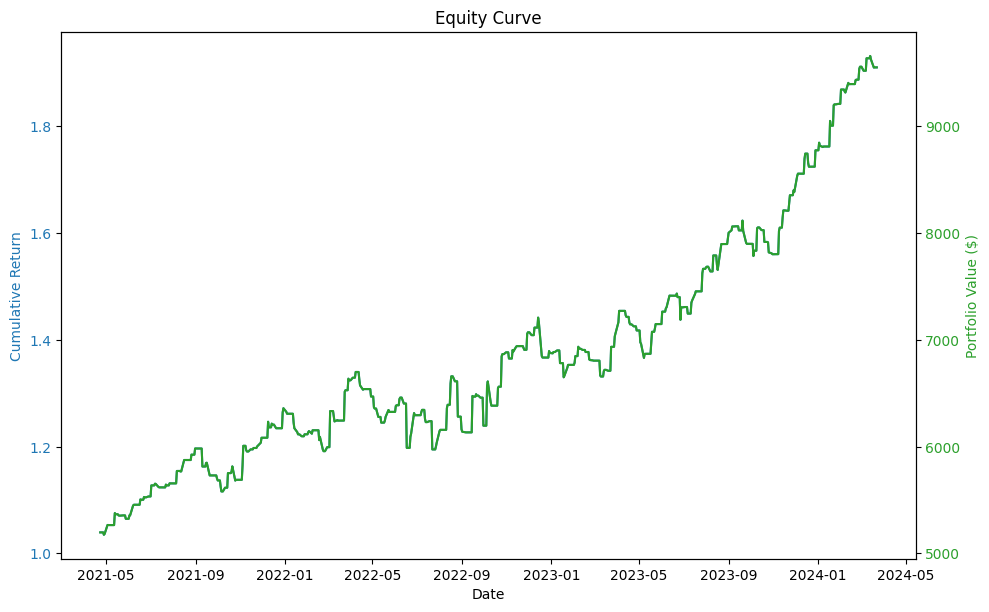

In [15]:
# Calculate weighted returns using mean-variance optimization weights
weighted_returns = returns.dot(mean_var_weights)

# Calculate cumulative returns
cumulative_returns = (1 + weighted_returns).cumprod()

# Calculate portfolio value in dollars
portfolio_value = initial_investment * cumulative_returns

# Plotting
fig, ax1 = plt.subplots(figsize=(10, 6))

color = 'tab:blue'
ax1.set_xlabel('Date')
ax1.set_ylabel('Cumulative Return', color=color)
ax1.plot(cumulative_returns, label='Cumulative Return of Portfolio', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# Instantiate a second axes that shares the same x-axis
ax2 = ax1.twinx()  
color = 'tab:green'
ax2.set_ylabel('Portfolio Value ($)', color=color)
ax2.plot(portfolio_value, label='Portfolio Value ($)', color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # Otherwise the right y-label is slightly clipped
plt.title('Equity Curve')
plt.show()

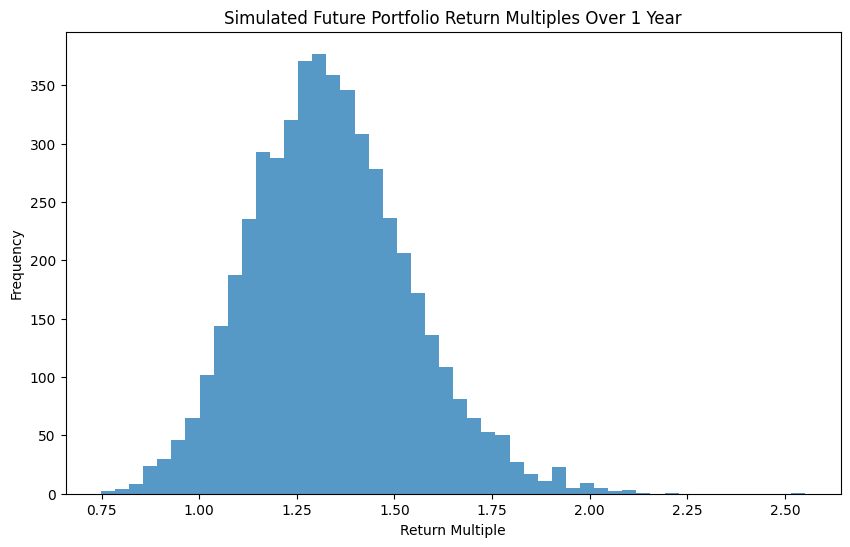

In [16]:
def monte_carlo_simulation(returns, weights, num_simulations=5000, time_horizon=252):
    """
    Perform a Monte Carlo simulation to project future portfolio return multiples.

    :param returns: DataFrame of historical returns for each asset
    :param weights: Array of portfolio weights for each asset
    :param num_simulations: Number of simulations to run (default=1000)
    :param time_horizon: Number of trading days in the future to simulate (default=252 for 1 year)
    :return: Simulated future portfolio return multiples
    """
    # Calculate mean and standard deviation of daily returns for each asset
    mean_returns = returns.mean()
    std_dev_returns = returns.std()

    # Number of assets
    n = len(weights)
    
    # Initialize array to store results of each simulation
    future_return_multiples = np.zeros(num_simulations)
    
    for i in range(num_simulations):
        # Generate random daily returns for each asset, assume returns are normally distributed
        random_returns = np.random.normal(mean_returns, std_dev_returns, (time_horizon, n))
        
        # Calculate daily portfolio returns by weighting the random returns
        daily_portfolio_returns = random_returns.dot(weights)
        
        # Calculate cumulative return multiple at the end of the time horizon
        future_return_multiples[i] = np.prod(1 + daily_portfolio_returns)
    
    return future_return_multiples

# Assuming mean_var_weights are the weights obtained from mean-variance optimization
simulated_return_multiples = monte_carlo_simulation(returns, mean_var_weights)

# Plotting the distribution of simulated future return multiples
plt.figure(figsize=(10, 6))
plt.hist(simulated_return_multiples, bins=50, alpha=0.75)
plt.title('Simulated Future Portfolio Return Multiples Over 1 Year')
plt.xlabel('Return Multiple')
plt.ylabel('Frequency')
plt.show()

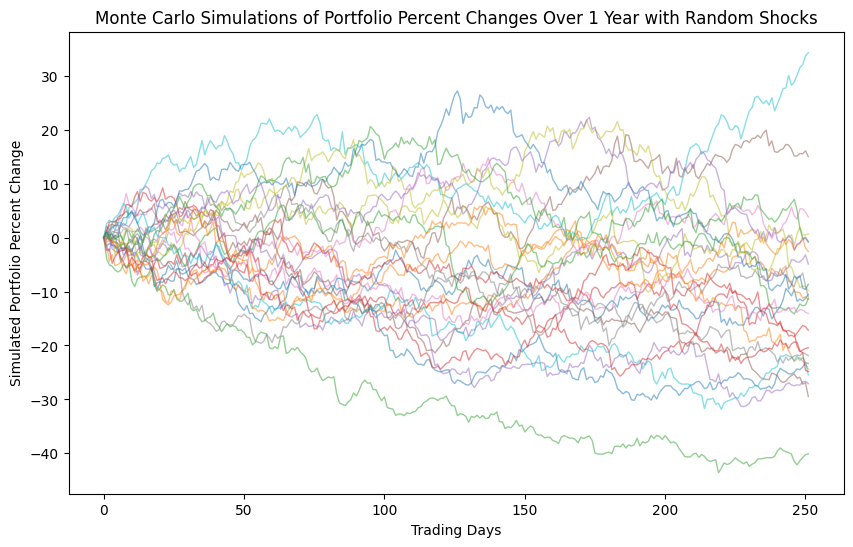

In [23]:
def simulate_portfolio_paths(returns, weights, num_paths=1000, num_trading_days=252, 
                             chance_of_bad_news=0.01, bad_news_impact=-0.05,
                             chance_of_bad_market=0.02, bad_market_impact=-0.03):
    """
    Simulate multiple potential future price paths for a portfolio over a year,
    incorporating random bad news and market downturns.
    This version calculates and returns the percent change in price rather than the price itself.
    
    :param returns: DataFrame of historical daily returns for each asset
    :param weights: Array of portfolio weights for each asset
    :param num_paths: Number of price paths to simulate
    :param num_trading_days: Number of trading days to simulate
    :param chance_of_bad_news: Probability of bad news on any given day
    :param bad_news_impact: Impact of bad news on returns
    :param chance_of_bad_market: Probability of a bad market day
    :param bad_market_impact: Impact of a bad market day on returns
    :return: Array of simulated percent changes in price paths
    """
    mean_daily_returns = returns.mean()
    std_daily_returns = returns.std()
    
    # Initialize the results array
    simulation_results = np.zeros((num_trading_days, num_paths))
    
    for path in range(num_paths):
        daily_changes = [0]  # Start with 0% change
        for _ in range(1, num_trading_days):
            random_return = np.random.normal(mean_daily_returns, std_daily_returns)
            daily_return = np.dot(weights, random_return)
            
            if np.random.rand() < chance_of_bad_news:
                daily_return += bad_news_impact
            
            if np.random.rand() < chance_of_bad_market:
                daily_return += bad_market_impact
            
            # Calculate the percent change instead of the price
            new_change = (daily_changes[-1] + 1) * (1 + daily_return) - 1
            daily_changes.append(new_change)
        
        simulation_results[:, path] = daily_changes

    return simulation_results

simulated_percent_changes = simulate_portfolio_paths(returns, weights=mean_var_weights, num_paths=25, 
                                                     chance_of_bad_news=0.03, 
                                                     bad_news_impact=-0.025,
                                                     chance_of_bad_market=0.04, 
                                                     bad_market_impact=-0.025)

# Plot the simulation of percent changes
plt.figure(figsize=(10, 6))
for i in range(simulated_percent_changes.shape[1]):
    plt.plot(simulated_percent_changes[:, i] * 100, lw=1, alpha=0.5)  # Convert to percentage
plt.title('Monte Carlo Simulations of Portfolio Percent Changes Over 1 Year with Random Shocks')
plt.xlabel('Trading Days')
plt.ylabel('Simulated Portfolio Percent Change')
plt.show()

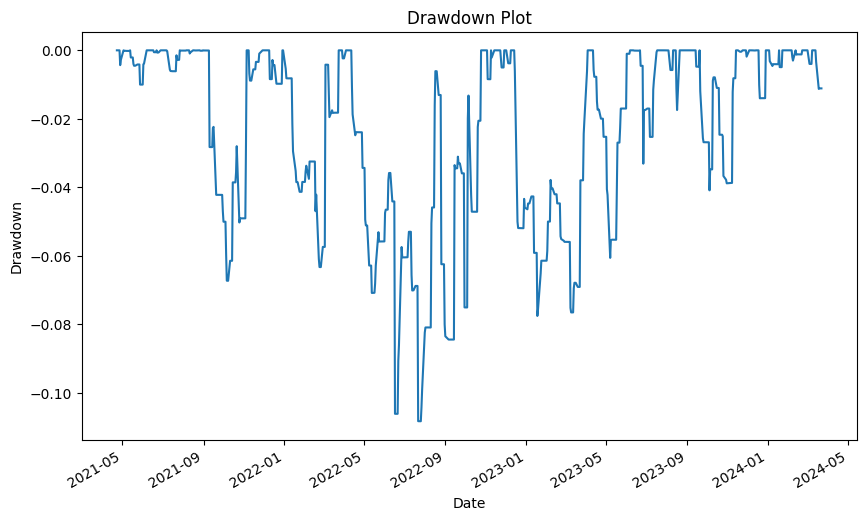

In [24]:
def plot_drawdowns(cumulative_returns):
    # Calculate the running maximum
    running_max = np.maximum.accumulate(cumulative_returns)
    # Calculate the drawdown
    drawdowns = (cumulative_returns - running_max) / running_max

    drawdowns.plot(figsize=(10, 6))
    plt.title('Drawdown Plot')
    plt.xlabel('Date')
    plt.ylabel('Drawdown')
    plt.show()

plot_drawdowns(cumulative_returns)

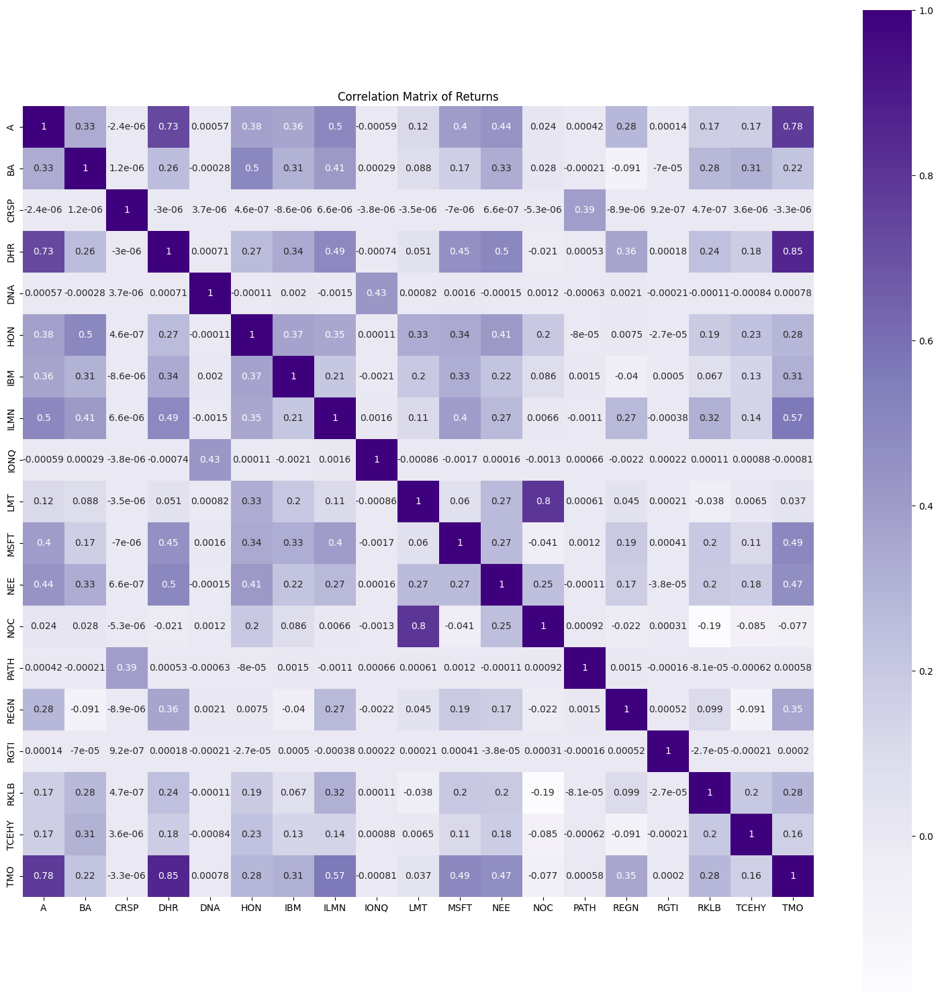

In [28]:
# Assuming 'returns' is a pandas DataFrame with your return data
correlation_matrix = returns.corr()

# Calculate the figure size, one inch per category
fig_size = len(correlation_matrix.columns)  # half an inch per variable as an example
plt.figure(figsize=(fig_size, fig_size))

sns.heatmap(correlation_matrix, annot=True, cmap='Purples', square=True)
plt.title('Correlation Matrix of Returns')
plt.show()

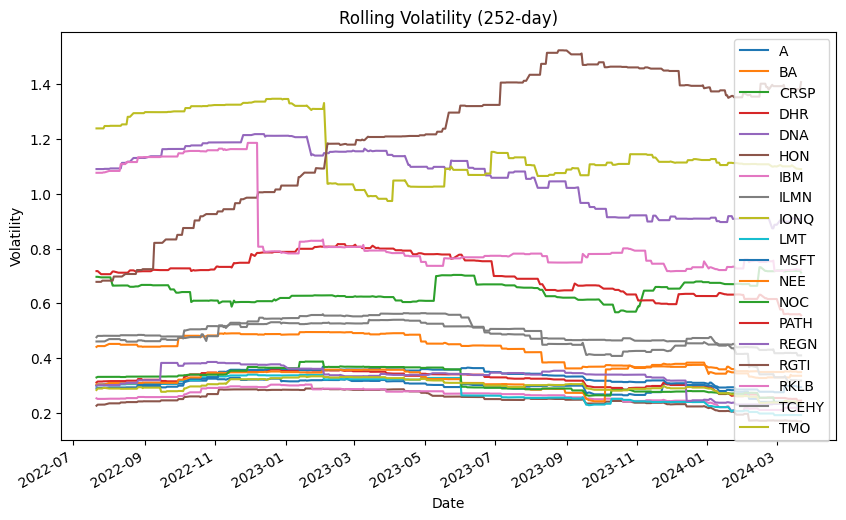

In [29]:
rolling_volatility = returns.rolling(window=252).std() * np.sqrt(252)
rolling_volatility.plot(figsize=(10, 6))
plt.title('Rolling Volatility (252-day)')
plt.xlabel('Date')
plt.ylabel('Volatility')
plt.show()

In [30]:
# Calculate expected returns and covariance matrix
mean_returns = returns.mean() * 52
cov_matrix = returns.cov() * 52**2

min_var_weights = minimize_variance(returns)
mean_var_weights = mean_variance_optimization(returns)

annual_return_min_var = np.sum((mean_returns * min_var_weights))
annual_vol_min_var = np.sqrt(np.dot(min_var_weights.T, np.dot(cov_matrix, min_var_weights)))

# Sharpe ratio for the minimum variance portfolio
sharpe_ratio_min_var = annual_return_min_var / annual_vol_min_var

# Expected return and volatility for mean-variance optimization
annual_return_mean_var = np.sum((mean_returns * mean_var_weights))
annual_vol_mean_var = np.sqrt(np.dot(mean_var_weights.T, np.dot(cov_matrix, mean_var_weights)))

# Sharpe ratio for the mean-variance optimized portfolio
sharpe_ratio_mean_var = annual_return_mean_var / annual_vol_mean_var

# Set the number of portfolios to simulate
num_portfolios = 25000
all_weights = np.zeros((num_portfolios, len(returns.columns)))
ret_arr = np.zeros(num_portfolios)
vol_arr = np.zeros(num_portfolios)
sharpe_arr = np.zeros(num_portfolios)

for i in range(num_portfolios):
    # Create random weight vectors and normalize them to sum to 1
    weights = np.array(np.random.random(len(returns.columns)))
    weights = weights / np.sum(weights)
    
    # Save weights
    all_weights[i, :] = weights
    
    # Expected returns for the portfolio
    ret_arr[i] = np.sum((mean_returns * weights))
    
    # Expected volatility for the portfolio
    vol_arr[i] = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))
    
    # Sharpe Ratio - Since we're not subtracting risk-free rate, this is just return/volatility
    sharpe_arr[i] = ret_arr[i] / vol_arr[i]


# Highlight the point with the highest Sharpe ratio
max_sr_ret = ret_arr[sharpe_arr.argmax()]
max_sr_vol = vol_arr[sharpe_arr.argmax()]

# Prepare hover texts as previously described
hover_texts = []
for i in range(num_portfolios):
    hover_text = f"Return: {ret_arr[i]*100:.2f}%<br>Volatility: {vol_arr[i]*100:.2f}%<br>Sharpe Ratio: {sharpe_arr[i]:.2f}"
    for j, weight in enumerate(all_weights[i]):
        hover_text += f"<br>{returns.columns[j]}: {weight:.4f}"
    hover_texts.append(hover_text)

# Create a scatter plot
fig = go.Figure()

# Add the scatter plot for portfolios
fig.add_trace(go.Scatter(x=vol_arr, y=ret_arr, mode='markers', 
                         marker=dict(size=8, color=sharpe_arr, colorscale='RdYlGn', 
                                     colorbar=dict(title='Sharpe Ratio')),
                         text=hover_texts, hoverinfo="text", name="Random Portfolio"))

# Highlight the maximum Sharpe ratio point
fig.add_trace(go.Scatter(x=[max_sr_vol], y=[max_sr_ret], mode='markers', 
                         marker=dict(color='limegreen', size=12, 
                                     line=dict(width=2, color='black')), text=hover_texts, hoverinfo="text", name="Maximum Sharpe Ratio"))

# Highlight the minimum variance portfolio
fig.add_trace(go.Scatter(x=[annual_vol_min_var], y=[annual_return_min_var], mode='markers', 
                         marker=dict(color='midnightblue', size=12, 
                                     line=dict(width=2, color='black')), name='Min Variance'))

# Highlight the mean-variance optimized portfolio
fig.add_trace(go.Scatter(x=[annual_vol_mean_var], y=[annual_return_mean_var], mode='markers', 
                         marker=dict(color='gold', size=12, 
                                     line=dict(width=2, color='black')), name='Mean Variance'))

# Update the layout to add titles, axis labels, and adjust legend and color bar
fig.update_layout(
    title='Efficient Frontier',
    xaxis_title='Volatility',
    yaxis_title='Return',
    width=1000,
    height=700,
    legend=dict(x=0, y=1, traceorder='normal'),
    coloraxis_colorbar=dict(x=0.9)
)

# Show the figure
fig.show()